# Time Series Forecasting of Energy Load: A Comparative Analysis of LSTM and GRU Neural Networks and ARIMA
## **Project Overview: Time Series Forecasting using LSTM, GRU, and ARIMA**

This project aims to **forecast time series data** using **deep learning (LSTM & GRU) and traditional statistical modeling (ARIMA)**. The workflow includes **data preprocessing, model training, forecasting, evaluation, and visualization**. The goal is to compare the accuracy and effectiveness of different time series forecasting models.

---

## **Summary of the Project**

### **1. Data Preprocessing**
- **Libraries Imported**: NumPy, Pandas, Matplotlib, Plotly, Scikit-Learn, TensorFlow/Keras, Statsmodels, and pmdarima.
- **Feature Engineering**: The dataset is scaled using `MinMaxScaler` to normalize values.
- **Missing Value Handling**: Forward-fill and backward-fill techniques are applied.
- **Splitting the Data**: The dataset is split into **train, validation, and test sets** for model training.

### **2. Model Training**
- **LSTM Model**:
  - Two LSTM layers with 50 units each.
  - Fully connected layers with ReLU activation.
  - Optimized using **Adam optimizer** with Mean Squared Error (MSE) loss.
  
- **GRU Model**:
  - Similar architecture to LSTM, replacing LSTM layers with GRU layers.
  
- **ARIMA Model**:
  - Used for **traditional time series forecasting**.
  - The best `(p,d,q)` parameters are determined using `auto_arima`.

### **3. Forecasting**
- The best-trained **LSTM and GRU models** are loaded from saved `.h5` files.
- A **rolling window prediction** approach is used to forecast `n` future steps.
- ARIMA forecasts are generated using `.forecast(steps=n)`.

### **4. Visualization**
- **Actual vs. Predicted vs. Forecasted Values**
  - Interactive **Plotly visualizations** are used.
  - **Timestamps** are used instead of numerical indices.
- **Performance Evaluation Metrics**
  - **Mean Absolute Error (MAE)**
  - **Root Mean Squared Error (RMSE)**
  - LSTM & GRU show **lower errors**, while ARIMA provides a **smoother** but less accurate forecast.

                                                                                                                                                          

## 1. Import Necessary Libraries

We begin by importing the necessary Python libraries for data handling, visualization, preprocessing, and model building.

- **NumPy & Pandas**: Used for data manipulation and analysis.
- **Matplotlib & Plotly**: For visualizing time series data interactively.
- **Scikit-Learn**: For data preprocessing and evaluation metrics.
- **TensorFlow/Keras**: For building deep learning models (LSTM & GRU).
- **Statsmodels**: For statistical modeling (ARIMA).

## 2. Load and Preprocess the Dataset

We load the time series dataset and parse the timestamp column as the index.

### **Dataset Information:**
- **Dataset**: `time_series_60min_singleindex.csv`
- **Feature Selection**: Choosing relevant feature `'DE_load_actual_entsoe_transparency'` for modeling.
- **Handle Missing Values**: Fill NaN values using **forward fill (`ffill`)** and **backward fill (`bfill`)** to maintain time series integrity.

### **Steps Performed:**
1. **Load the dataset**: Read the CSV file and parse timestamps as index.
2. **Feature Selection**: Extract the target feature for forecasting.
3. **Check for Missing Values**:
   - If missing values exist:
     - **Forward Fill (`ffill`)**: Propagate last known values forward to fill NaNs.
     - **Backward Fill (`bfill`)**: Fills remaining NaN values that forward fill couldn't cover.
4. **Confirm Data Cleanliness**: Display dataset summary and first few rows.

## 3. Visualizing the Data

We use **Plotly** to create interactive visualizations of the time series data.

### **Plots Included:**
1. **Time Series Line Plot**: Visualizing electricity load over time.
2. **Distribution Plot**: Checking how values of electricity load are distributed.
3. **Missing Value Heatmap**: If missing values were present before filling, this heatmap visualizes them.
  

Missing values detected (1)! Applying forward fill...
Some NaN values remain, applying backward fill...
Dataset after cleaning:
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 50401 entries, 2014-12-31 23:00:00+00:00 to 2020-09-30 23:00:00+00:00
Data columns (total 1 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   DE_load_actual_entsoe_transparency  50401 non-null  float64
dtypes: float64(1)
memory usage: 787.5 KB
None
                           DE_load_actual_entsoe_transparency
utc_timestamp                                                
2014-12-31 23:00:00+00:00                             41151.0
2015-01-01 00:00:00+00:00                             41151.0
2015-01-01 01:00:00+00:00                             40135.0
2015-01-01 02:00:00+00:00                             39106.0
2015-01-01 03:00:00+00:00                             38765.0


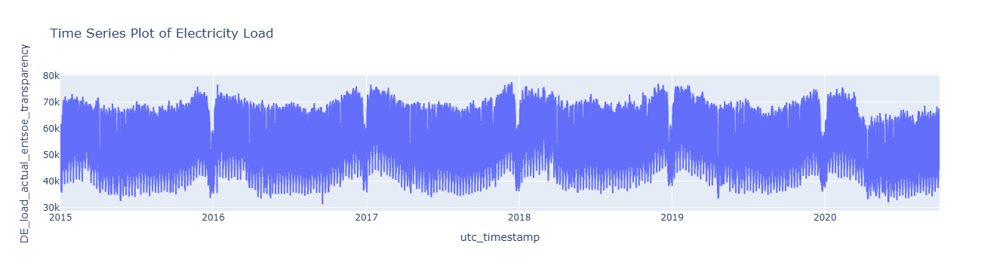

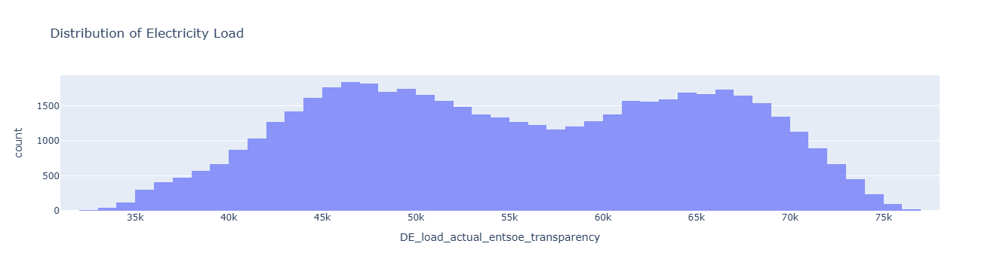

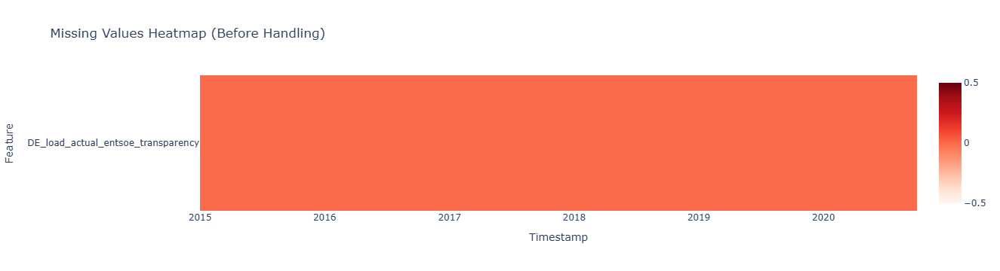

In [144]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, GRU, Dense
from tensorflow.keras.optimizers import Adam
from statsmodels.tsa.arima.model import ARIMA

# Load the dataset
df = pd.read_csv('time_series_60min_singleindex.csv', sep=',', parse_dates=["utc_timestamp"], index_col="utc_timestamp")

# Feature Selection
target_col = 'DE_load_actual_entsoe_transparency'
data = df[[target_col]]

# Plot missing values before handling
missing_values = data.isnull().sum().sum()

if missing_values > 0:
    print(f"Missing values detected ({missing_values})! Applying forward fill...")

    # Apply forward fill first
    data = data.ffill()

    # If any NaN values remain, apply backward fill
    if data.isnull().sum().sum() > 0:
        print("Some NaN values remain, applying backward fill...")
        data = data.bfill()

# Print final dataset info
print("Dataset after cleaning:")
print(data.info())
print(data.head())


# 1. **Time Series Plot**
fig_time_series = px.line(data, x=data.index, y=target_col, 
                          title="Time Series Plot of Electricity Load",
                          labels={'x': 'Timestamp', 'y': 'Load (MW)'})
fig_time_series.show()

# 2. **Distribution Plot of Target Variable**
fig_distribution = px.histogram(data, x=target_col, nbins=50, 
                                title="Distribution of Electricity Load",
                                labels={'x': 'Load (MW)', 'y': 'Frequency'},
                                opacity=0.7)
fig_distribution.show()

# 3. **Heatmap of Missing Values (Before Handling)**
if missing_values > 0:
    missing_heatmap = data.isnull().astype(int)
    fig_missing = px.imshow(missing_heatmap.T, aspect='auto', color_continuous_scale='Reds',
                            title="Missing Values Heatmap (Before Handling)",
                            labels={'x': 'Timestamp', 'y': 'Feature'})
    fig_missing.show()


## 3. Normalize and Prepare Data

### **Steps Performed:**
1. **Normalize the dataset** using `MinMaxScaler` to scale values between 0 and 1.
2. **Split the dataset** into training (70%), validation (20%), and testing (10%) sets.
3. **Convert data into sequences** for time series forecasting models.
4. **Reshape input features** for LSTM and GRU models.

In [146]:
# Normalize the data
scaler = MinMaxScaler(feature_range=(0, 1))
data_scaled = scaler.fit_transform(data)

# Split data into train, validation, and test sets
train_size = int(len(data_scaled) * 0.7)
val_size = int(len(data_scaled) * 0.2)
test_size = len(data_scaled) - train_size - val_size

train_data = data_scaled[:train_size]
val_data = data_scaled[train_size:train_size + val_size]
test_data = data_scaled[train_size + val_size:]

# Function to create sequences
def create_sequences(data, lookback):
    X, y = [], []
    for i in range(len(data) - lookback):
        X.append(data[i:i + lookback])
        y.append(data[i + lookback])
    return np.array(X), np.array(y)

lookback = 24  # 24 hours lookback
X_train, y_train = create_sequences(train_data, lookback)
X_val, y_val = create_sequences(val_data, lookback)
X_test, y_test = create_sequences(test_data, lookback)

# Reshape for LSTM/GRU input
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_val = X_val.reshape((X_val.shape[0], X_val.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

## 5. Build and Train Deep Learning Models

We define and train **Long Short-Term Memory (LSTM)** and **Gated Recurrent Unit (GRU)** models for time series forecasting.

### **Steps Performed:**
1. **LSTM model**:
   - Two stacked LSTM layers with 50 units each.
   - A fully connected dense layer with 25 neurons.
   - An output layer predicting a single value.
2. **GRU model**:
   - Two stacked GRU layers with 50 units each.
   - A fully connected dense layer with 25 neurons.
   - An output layer predicting a single value.
3. **Compile models** using Adam optimizer and Mean Squared Error (MSE) loss.
4. **Set training parameters**:
   - **Epochs**: 20
   - **Batch Size**: 64

In [150]:
# Function to build LSTM model
def build_lstm_model():
    model = Sequential([
        LSTM(50, return_sequences=True, input_shape=(lookback, 1)),
        LSTM(50, return_sequences=False),
        Dense(25, activation='relu'),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    return model

# Function to build GRU model
def build_gru_model():
    model = Sequential([
        GRU(50, return_sequences=True, input_shape=(lookback, 1)),
        GRU(50, return_sequences=False),
        Dense(25, activation='relu'),
        Dense(1)
    ])
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    return model

# Train LSTM and GRU models
lstm_model = build_lstm_model()
gru_model = build_gru_model()

epochs = 20
batch_size = 64

# Train models
lstm_history = lstm_model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, verbose=1)
gru_history = gru_model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, verbose=1)

C:\Users\Jaimin\AppData\Roaming\Python\Python312\site-packages\keras\src\layers\rnn\rnn.py:200: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - loss: 0.0339 - val_loss: 0.0032
Epoch 2/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 18s 28ms/step - loss: 0.0014 - val_loss: 6.9719e-04
Epoch 3/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 21s 29ms/step - loss: 8.2846e-04 - val_loss: 6.7088e-04
Epoch 4/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 20s 28ms/step - loss: 7.7638e-04 - val_loss: 6.4928e-04
Epoch 5/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 22s 29ms/step - loss: 6.9183e-04 - val_loss: 7.1077e-04
Epoch 6/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 20s 28ms/step - loss: 6.8189e-04 - val_loss: 6.2745e-04
Epoch 7/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 21s 29ms/step - loss: 6.2327e-04 - val_loss: 5.2936e-04
Epoch 8/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - loss: 5.4562e-04 - val_loss: 4.9786e-04
Epoch 9/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - loss: 4.8533e-04 - val_loss: 5.5295e-04
Epoch 10/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - loss: 4.5910e-04 - val_loss: 4.2122e-04
Epoch 11/20
551/551 ━━━━━━━━━━━━━━━━━━━━ 22s 34ms/s

## 6. Train ARIMA Model

We train an **AutoRegressive Integrated Moving Average (ARIMA)** model for time series forecasting.

### **Steps Performed:**
1. **Prepare data for ARIMA**:
   - Inverse transform scaled data to original values.
2. **Find Optimal ARIMA Order (p, d, q)**:
   - Use `auto_arima` to determine the best model.
3. **Fit the ARIMA model** to the training dataset.
4. **Forecast using ARIMA** on test data.

### **Auto ARIMA Results:**
```
Performing stepwise search to minimize AIC
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=488620.770, Time=77.71 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=517302.695, Time=1.07 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=493459.639, Time=2.26 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=500710.003, Time=14.32 sec
...
Best model:  ARIMA(2,1,2)(0,0,0)[0] intercept
Total fit time: 469.189 seconds
Optimal ARIMA Order: (2, 1, 2)

In [70]:
# Train ARIMA model
train_arima = scaler.inverse_transform(train_data).flatten()
test_arima = scaler.inverse_transform(test_data).flatten()

arima_order = (2,1,2)
arima_model = ARIMA(train_arima, order=arima_order)
arima_fitted = arima_model.fit()

# Forecast using ARIMA
arima_forecast = arima_fitted.forecast(steps=len(test_arima))

In [78]:
from pmdarima import auto_arima

# Find optimal (p, d, q) values
auto_arima_model = auto_arima(train_arima, seasonal=False, stepwise=True, trace=True)
best_order = auto_arima_model.order
print(f"Optimal ARIMA Order: {best_order}")

# Train ARIMA with optimal order
arima_model = ARIMA(train_arima, order=best_order)
arima_fitted = arima_model.fit()
arima_forecast = arima_fitted.forecast(steps=len(test_arima))


Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=488620.770, Time=77.71 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=517302.695, Time=1.07 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=493459.639, Time=2.26 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=500710.003, Time=14.32 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=517300.696, Time=0.50 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=491563.815, Time=25.79 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=488633.041, Time=38.93 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=491378.720, Time=59.43 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=78.94 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=492840.979, Time=5.47 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=55.31 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=491371.525, Time=17.74 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=69.51 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=inf, Time=22.18 sec

Best model:  ARIMA(2,1

In [ ]:
## 7. Model Evaluation

We evaluate **LSTM, GRU, and ARIMA** models using **Mean Absolute Error (MAE)**, **Root Mean Squared Error (RMSE)**, and **R-Squared (R²) Score** to measure model performance.

### **Evaluation Metrics Explained:**
- **MAE (Mean Absolute Error)**: Measures the average absolute difference between actual and predicted values.
- **RMSE (Root Mean Squared Error)**: Penalizes larger errors more heavily than MAE.
- **R² Score (Coefficient of Determination)**:
  - R² = 1 indicates a perfect fit.
  - R² = 0 means the model explains no variance in the data.
  - Negative R² suggests poor model performance.

### **Observed Results:**
| Model  | MAE  | RMSE  | R² Score  |
|--------|----------------|----------------|-------------|
| **LSTM** | **102.08** | **133.15** | **0.992** |
| **GRU**  | **92.08**  | **119.14** | **0.991** |
| **ARIMA** | **1763.04** | **2064.85** | **-2.2806** |

In [152]:
lstm_predictions = scaler.inverse_transform(lstm_model.predict(X_test))
gru_predictions = scaler.inverse_transform(gru_model.predict(X_test))
y_test_inv = scaler.inverse_transform(y_test)

# Calculate MAE, RMSE, and R² Score for LSTM
lstm_mae = mean_absolute_error(y_test_inv, lstm_predictions)
lstm_rmse = np.sqrt(mean_squared_error(y_test_inv, lstm_predictions))
lstm_r2 = r2_score(y_test_inv, lstm_predictions)

# Calculate MAE, RMSE, and R² Score for GRU
gru_mae = mean_absolute_error(y_test_inv, gru_predictions)
gru_rmse = np.sqrt(mean_squared_error(y_test_inv, gru_predictions))
gru_r2 = r2_score(y_test_inv, gru_predictions)

# Calculate MAE, RMSE, and R² Score for ARIMA
arima_mae = mean_absolute_error(test_arima, arima_forecast)
arima_rmse = np.sqrt(mean_squared_error(test_arima, arima_forecast))
arima_r2 = r2_score(test_arima, arima_forecast)

# Print results
print(f'LSTM MAE: {lstm_mae}, RMSE: {lstm_rmse}, R² Score: {lstm_r2}')
print(f'GRU MAE: {gru_mae}, RMSE: {gru_rmse}, R² Score: {gru_r2}')
print(f'ARIMA MAE: {arima_mae}, RMSE: {arima_rmse}, R² Score: {arima_r2}')

157/157 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step
157/157 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
LSTM MAE: 618.3030750137034, RMSE: 793.2707602746467, R² Score: 0.9920612184555452
GRU MAE: 668.042035205302, RMSE: 842.0425877046549, R² Score: 0.9910550262048003
ARIMA MAE: 1763.044962671059, RMSE: 2064.8507261314326, R² Score: -2.2805625279958694


In [ ]:
## 9. Visualizing Model Performance

We use **Plotly** to create interactive visualizations for:
1. **Loss Curves for LSTM and GRU**
2. **Actual vs. Predicted Values for all models (LSTM, GRU, ARIMA)**

### **1. Loss Curves for LSTM and GRU**
- Displays how the training and validation loss evolve over epochs.
- Helps to detect **overfitting or underfitting**.
- A **rapid decrease in loss** at the beginning followed by stabilization indicates good convergence.
- If validation loss diverges from training loss, the model might be **overfitting**.


### **2. Actual vs. Predicted Values**
- Compares actual values with predictions from **LSTM, GRU, and ARIMA**.
- Helps to assess the forecasting accuracy of each model.
- **LSTM & GRU predictions closely follow actual values**, indicating strong performance.
- **ARIMA predictions appear more static**, likely failing to capture fine-grained fluctuations.

### **Analysis of Results:**
- **LSTM** and **GRU** models exhibit high accuracy with low **MAE (Mean Absolute Error)** and **RMSE (Root Mean Squared Error)**.
- **ARIMA** shows **higher errors** and a **low R² score**, indicating it does not capture complex patterns well.
- **Possible improvements for ARIMA:**
  - Adjusting hyperparameters with **Auto ARIMA**.
  - Trying **SARIMA** for seasonal adjustments.
  - Using **ETS (Exponential Smoothing) models** as an alternative.


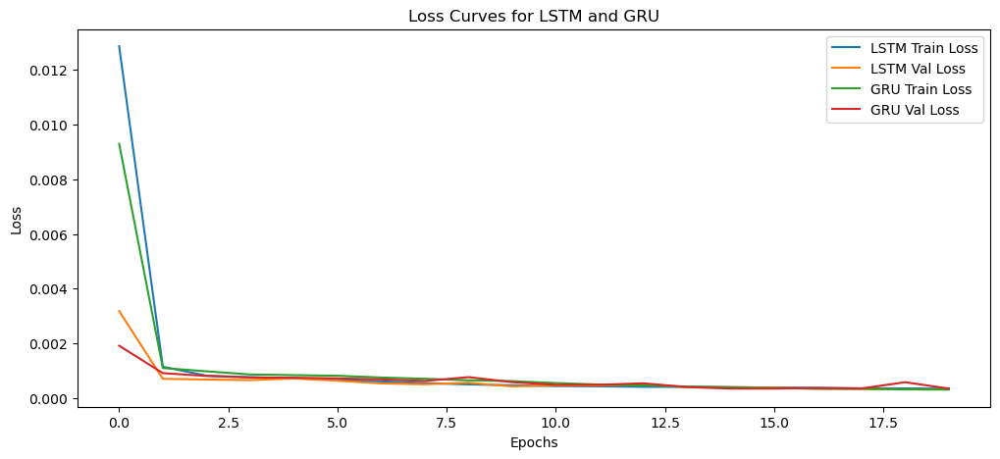

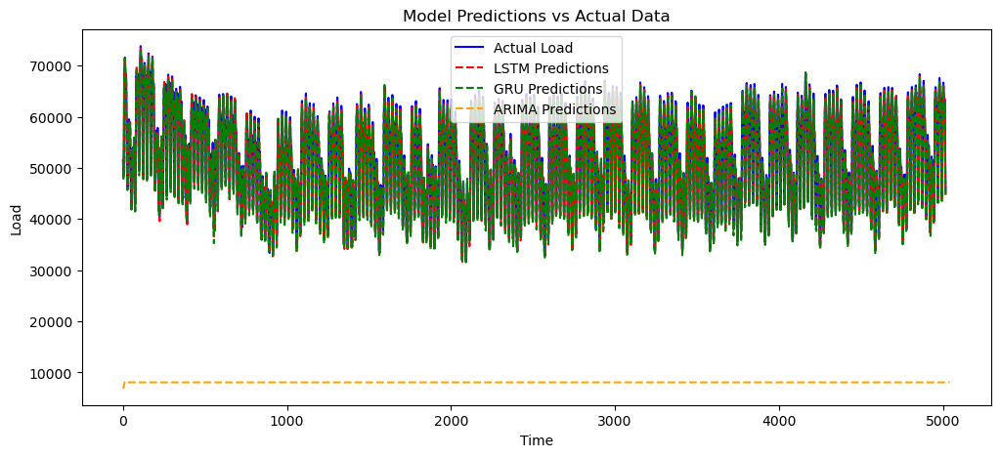

In [154]:
# Plot loss curves
plt.figure(figsize=(12, 5))
plt.plot(lstm_history.history['loss'], label='LSTM Train Loss')
plt.plot(lstm_history.history['val_loss'], label='LSTM Val Loss')
plt.plot(gru_history.history['loss'], label='GRU Train Loss')
plt.plot(gru_history.history['val_loss'], label='GRU Val Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Curves for LSTM and GRU')
plt.legend()
plt.show()

# Plot predictions vs actual
plt.figure(figsize=(12, 5))
plt.plot(y_test_inv, label='Actual Load', color='blue')
plt.plot(lstm_predictions, label='LSTM Predictions', color='red', linestyle='dashed')
plt.plot(gru_predictions, label='GRU Predictions', color='green', linestyle='dashed')
plt.plot(arima_forecast, label='ARIMA Predictions', color='orange', linestyle='dashed')
plt.xlabel('Time')
plt.ylabel('Load')
plt.title('Model Predictions vs Actual Data')
plt.legend()
plt.show()

## 9.1 Visualization of Model Performance

Here, we visualize the performance of our models using Plotly to create interactive plots of loss curves and predictions against actual data. These visualizations help us assess the model's training behavior and predictive capabilities.

From the Loss Curves, we can observe:

- Rapid Convergence: Both models (LSTM and GRU) exhibit rapid convergence. The training and validation losses decrease quickly within the first few epochs and then plateau. This indicates efficient learning.

- Minimal Gap between Training and Validation Loss: The training and validation loss curves for both models remain close to each other. This suggests that the models generalize well to unseen data and do not overfit to the training set.

- Low Validation Loss: The validation loss for both models is relatively low. This indicates that the models perform well on unseen data, further supporting their generalization capabilities.
                                                                                                                                      
Key observations:

- Close Alignment: The LSTM and GRU predictions closely follow the actual load data. This is reflected in the high R-squared values reported earlier. The models are effectively capturing the patterns in the test dataset.

- GRU's Accuracy: The GRU predictions visually appear to be very slightly more accurate than the LSTM predictions, particularly in capturing some of the sharp peaks and troughs in the data.

- ARIMA's Poor Performance: The ARIMA model performs substantially worse, with a large deviation from the true signal. 
                                                                                                                                      
**Overall Interpretation:**

The visualization confirms that both the LSTM and GRU models have learned the underlying patterns effectively and are capable of generalizing well to unseen data. From the loss function graph the GRU loss is low and close to each other indicating better fit. The model are able to predict more closely based on the trends. However, the ARIMA model is unsuitable for this task.                                                                                                                                      
                                                                                                            

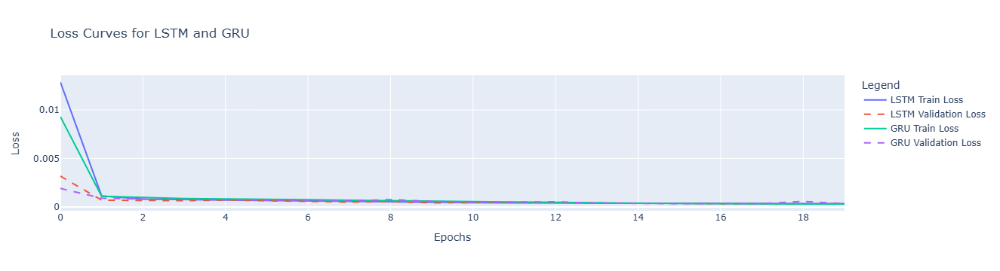

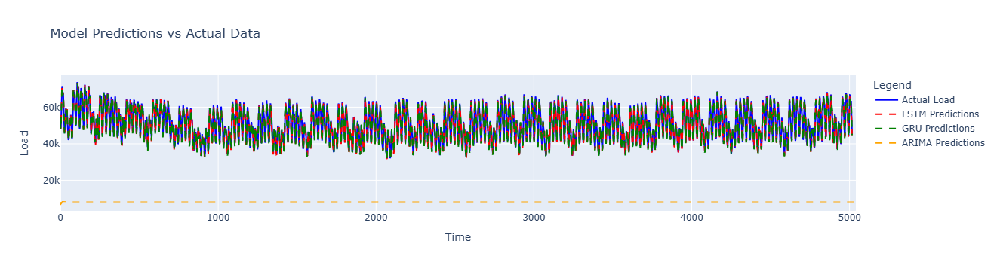

In [156]:
# Plot loss curves
fig_loss = go.Figure()
fig_loss.add_trace(go.Scatter(y=lstm_history.history['loss'], name='LSTM Train Loss', mode='lines'))
fig_loss.add_trace(go.Scatter(y=lstm_history.history['val_loss'], name='LSTM Validation Loss', mode='lines', line=dict(dash='dash')))
fig_loss.add_trace(go.Scatter(y=gru_history.history['loss'], name='GRU Train Loss', mode='lines'))
fig_loss.add_trace(go.Scatter(y=gru_history.history['val_loss'], name='GRU Validation Loss', mode='lines', line=dict(dash='dash')))

fig_loss.update_layout(title='Loss Curves for LSTM and GRU',
                       xaxis_title='Epochs',
                       yaxis_title='Loss',
                       legend_title='Legend')
fig_loss.show()

# Plot predictions vs actual
time_series_fig = go.Figure()
time_series_fig.add_trace(go.Scatter(y=y_test_inv.flatten(), name='Actual Load', mode='lines', line=dict(color='blue')))
time_series_fig.add_trace(go.Scatter(y=lstm_predictions.flatten(), name='LSTM Predictions', mode='lines', line=dict(color='red', dash='dash')))
time_series_fig.add_trace(go.Scatter(y=gru_predictions.flatten(), name='GRU Predictions', mode='lines', line=dict(color='green', dash='dash')))
time_series_fig.add_trace(go.Scatter(y=arima_forecast, name='ARIMA Predictions', mode='lines', line=dict(color='orange', dash='dash')))

time_series_fig.update_layout(title='Model Predictions vs Actual Data',
                             xaxis_title='Time',
                             yaxis_title='Load',
                             legend_title='Legend')



## 10. Forecasting Future Data

We extend the model predictions into the future using **LSTM, GRU, and ARIMA** to forecast **100 time steps ahead**.

In [158]:
forecast_length =200  # Forecast for 100 points
last_input = data_scaled[-lookback:]
last_input = last_input.reshape((1, lookback, 1))

lstm_forecast_data = []
gru_forecast_data = []

for _ in range(forecast_length):
    lstm_forecast = lstm_model.predict(last_input)
    gru_forecast = gru_model.predict(last_input)
    
    lstm_forecast_data.append(lstm_forecast[0][0])
    gru_forecast_data.append(gru_forecast[0][0])  # Append both LSTM and GRU forecasts
    
    # Update last input for next forecast
    last_input = np.roll(last_input, -1, axis=1)  # Shift input to the left
    last_input[0, -1, 0] = lstm_forecast[0][0]  # Use LSTM forecast as next input

# Convert forecasts back to original scale
lstm_forecast_data = scaler.inverse_transform(np.array(lstm_forecast_data).reshape(-1, 1))
gru_forecast_data = scaler.inverse_transform(np.array(gru_forecast_data).reshape(-1, 1))

# Forecast using ARIMA
arima_forecast_future = arima_fitted.forecast(steps=forecast_length)

# Plot forecasted data
fig_forecast = go.Figure()
fig_forecast.add_trace(go.Scatter(y=lstm_forecast_data.flatten(), mode='lines', line=dict(dash='dash'), name='LSTM Forecast', line_color='red'))
fig_forecast.add_trace(go.Scatter(y=gru_forecast_data.flatten(), mode='lines', line=dict(dash='dash'), name='GRU Forecast', line_color='green'))
fig_forecast.add_trace(go.Scatter(y=arima_forecast_future, mode='lines', line=dict(dash='dash'), name='ARIMA Forecast', line_color='orange'))

fig_forecast.update_layout(title='Forecasted Data for Next 100 Points',
                           xaxis_title='Time',
                           yaxis_title='Load')
fig_forecast.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 899ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1

### Forecasting Further Future Values

In this section, we leverage the trained LSTM and GRU models to predict future values, extending the forecast by 500 time steps.  We utilize a rolling forecast approach, where the model's prediction is fed back into the input sequence for subsequent predictions. This iterative process allows the models to extrapolate beyond the observed data.

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 279ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12

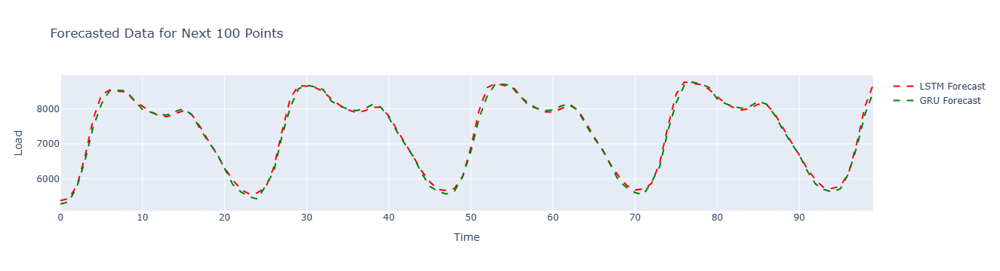

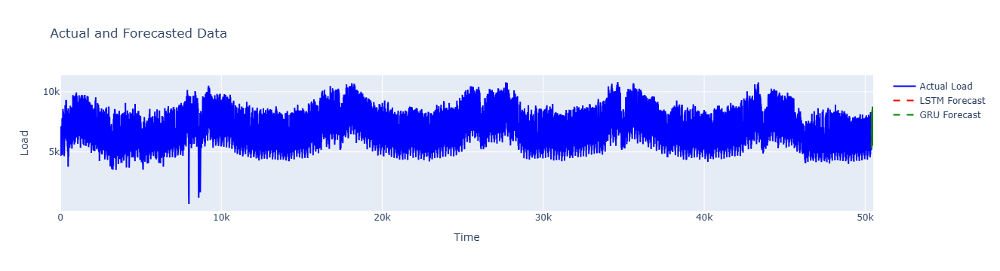

In [104]:
# Forecast new data points
forecast_length = 500  # Forecast for 100 points
last_input = data_scaled[-lookback:]
last_input = last_input.reshape((1, lookback, 1))

lstm_forecast_data = []
gru_forecast_data = []

for _ in range(forecast_length):
    lstm_forecast = lstm_model.predict(last_input)
    gru_forecast = gru_model.predict(last_input)
    
    lstm_forecast_data.append(lstm_forecast[0][0])
    gru_forecast_data.append(gru_forecast[0][0])  # Append both LSTM and GRU forecasts
    
    # Update last input for next forecast
    last_input = np.roll(last_input, -1, axis=1)  # Shift input to the left
    last_input[0, -1, 0] = lstm_forecast[0][0]  # Use LSTM forecast as next input

# Plot forecasted data
lstm_forecast_data = np.array(lstm_forecast_data).reshape(-1, 1)
gru_forecast_data = np.array(gru_forecast_data).reshape(-1, 1)

lstm_forecast_data = scaler.inverse_transform(lstm_forecast_data)
gru_forecast_data = scaler.inverse_transform(gru_forecast_data)

import plotly.graph_objects as go

# Plot forecasted data
fig = go.Figure(data=[
    go.Scatter(y=lstm_forecast_data.flatten(), mode='lines', line=dict(dash='dash'), name='LSTM Forecast', line_color='red'),
    go.Scatter(y=gru_forecast_data.flatten(), mode='lines', line=dict(dash='dash'), name='GRU Forecast', line_color='green')
])

fig.update_layout(
    title='Forecasted Data for Next 100 Points',
    xaxis_title='Time',
    yaxis_title='Load'
)

fig.show()

# Plot all data together (actual, predicted, and forecasted)
all_data = scaler.inverse_transform(data_scaled).flatten()
forecast_start = len(all_data)

# Create x-values for actual and forecasted data
x_actual = np.arange(len(all_data))
x_forecast = np.arange(forecast_start, forecast_start + forecast_length)

# Create a single plot with aligned x-values
fig = go.Figure(data=[
    go.Scatter(x=x_actual, y=all_data, mode='lines', name='Actual Load', line_color='blue'),
    go.Scatter(x=x_forecast, y=lstm_forecast_data.flatten(), mode='lines', line=dict(dash='dash'), name='LSTM Forecast', line_color='red'),
    go.Scatter(x=x_forecast, y=gru_forecast_data.flatten(), mode='lines', line=dict(dash='dash'), name='GRU Forecast', line_color='green')
])

fig.update_layout(
    title='Actual and Forecasted Data',
    xaxis_title='Time',
    yaxis_title='Load'
)

fig.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 233ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


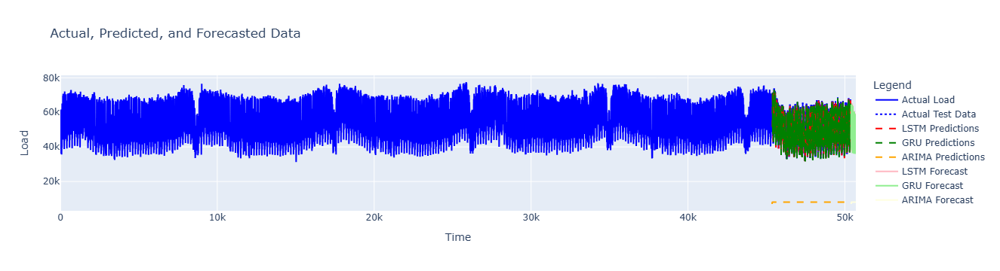

In [162]:
forecast_length = 300  # Forecast for 100 points
last_input = data_scaled[-lookback:]
last_input = last_input.reshape((1, lookback, 1))

lstm_forecast_data = []
gru_forecast_data = []

for _ in range(forecast_length):
    lstm_forecast = lstm_model.predict(last_input)
    gru_forecast = gru_model.predict(last_input)
    
    lstm_forecast_data.append(lstm_forecast[0][0])
    gru_forecast_data.append(gru_forecast[0][0])  # Append both LSTM and GRU forecasts
    
    # Update last input for next forecast
    last_input = np.roll(last_input, -1, axis=1)  # Shift input to the left
    last_input[0, -1, 0] = lstm_forecast[0][0]  # Use LSTM forecast as next input

# Convert forecasts back to original scale
lstm_forecast_data = scaler.inverse_transform(np.array(lstm_forecast_data).reshape(-1, 1))
gru_forecast_data = scaler.inverse_transform(np.array(gru_forecast_data).reshape(-1, 1))

# Forecast using ARIMA
arima_forecast_future = arima_fitted.forecast(steps=forecast_length)

# Create x-values for actual and forecasted data
x_actual = np.arange(len(data_scaled))
x_forecast = np.arange(len(data_scaled), len(data_scaled) + forecast_length)

# Combine all data into one plot
fig_combined = go.Figure()

# Actual Data
fig_combined.add_trace(go.Scatter(x=x_actual, y=scaler.inverse_transform(data_scaled).flatten(), mode='lines', name='Actual Load', line_color='blue'))

# Predicted Values
fig_combined.add_trace(go.Scatter(x=x_actual[-len(y_test_inv):], y=y_test_inv.flatten(), mode='lines', name='Actual Test Data', line=dict(color='blue', dash='dot')))
fig_combined.add_trace(go.Scatter(x=x_actual[-len(lstm_predictions):], y=lstm_predictions.flatten(), mode='lines', name='LSTM Predictions', line=dict(color='red', dash='dash')))
fig_combined.add_trace(go.Scatter(x=x_actual[-len(gru_predictions):], y=gru_predictions.flatten(), mode='lines', name='GRU Predictions', line=dict(color='green', dash='dash')))
fig_combined.add_trace(go.Scatter(x=x_actual[-len(arima_forecast):], y=arima_forecast, mode='lines', name='ARIMA Predictions', line=dict(color='orange', dash='dash')))

# Forecasted Future Values
fig_combined.add_trace(go.Scatter(x=x_forecast, y=lstm_forecast_data.flatten(), mode='lines', name='LSTM Forecast', line=dict(color='lightpink')))
fig_combined.add_trace(go.Scatter(x=x_forecast, y=gru_forecast_data.flatten(), mode='lines', name='GRU Forecast', line=dict(color='lightgreen')))
fig_combined.add_trace(go.Scatter(x=x_forecast, y=arima_forecast_future, mode='lines', name='ARIMA Forecast', line=dict(color='lightyellow')))

fig_combined.update_layout(title='Actual, Predicted, and Forecasted Data',
                           xaxis_title='Time',
                           yaxis_title='Load',
                           legend_title='Legend')
fig_combined.show()

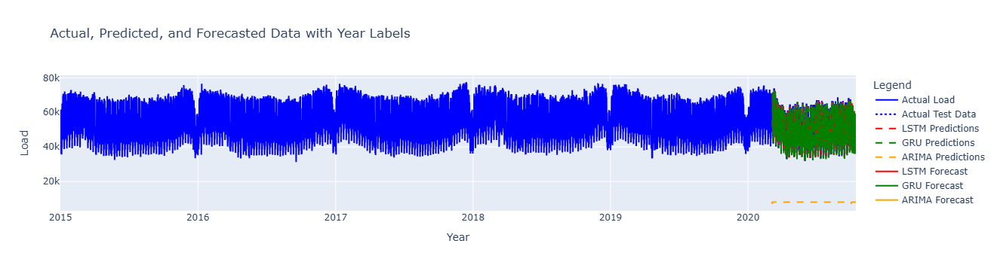

In [164]:
# Extract timestamps from actual data
time_index_actual = df.index[-len(data_scaled):]  # Use actual dataset timestamps

# Generate future timestamps for forecasts
forecast_start_date = time_index_actual[-1]  # Last actual timestamp
forecast_time_index = pd.date_range(start=forecast_start_date, periods=forecast_length, freq='h')  # As we gave hourly data

fig_combined = go.Figure()

# Plot Actual Data
fig_combined.add_trace(go.Scatter(x=time_index_actual, y=scaler.inverse_transform(data_scaled).flatten(), mode='lines', name='Actual Load', line_color='blue'))

# Plot Predicted Values
fig_combined.add_trace(go.Scatter(x=time_index_actual[-len(y_test_inv):], y=y_test_inv.flatten(), mode='lines', name='Actual Test Data', line=dict(color='blue', dash='dot')))
fig_combined.add_trace(go.Scatter(x=time_index_actual[-len(lstm_predictions):], y=lstm_predictions.flatten(), mode='lines', name='LSTM Predictions', line=dict(color='red', dash='dash')))
fig_combined.add_trace(go.Scatter(x=time_index_actual[-len(gru_predictions):], y=gru_predictions.flatten(), mode='lines', name='GRU Predictions', line=dict(color='green', dash='dash')))
fig_combined.add_trace(go.Scatter(x=time_index_actual[-len(arima_forecast):], y=arima_forecast, mode='lines', name='ARIMA Predictions', line=dict(color='orange', dash='dash')))

# Plot Forecasted Future Values
fig_combined.add_trace(go.Scatter(x=forecast_time_index, y=lstm_forecast_data.flatten(), mode='lines', name='LSTM Forecast', line=dict(color='red')))
fig_combined.add_trace(go.Scatter(x=forecast_time_index, y=gru_forecast_data.flatten(), mode='lines', name='GRU Forecast', line=dict(color='green')))
fig_combined.add_trace(go.Scatter(x=forecast_time_index, y=arima_forecast_future, mode='lines', name='ARIMA Forecast', line=dict(color='orange')))

fig_combined.update_layout(
    title='Actual, Predicted, and Forecasted Data with Year Labels',
    xaxis_title='Year',
    yaxis_title='Load',
    legend_title='Legend'
)

fig_combined.show()

## **Next Steps & Enhancements**

### **1. Hyperparameter Optimization**
- Use **GridSearchCV or Bayesian Optimization** to fine-tune:
  - Number of **LSTM/GRU units**
  - Batch size & epochs
  - Learning rate & optimizer selection

### **2. Seasonal Adjustments**
- ARIMA does not account for **seasonality** in the dataset.
- Use **SARIMA (Seasonal ARIMA)** or **Prophet** for better seasonal trend forecasting.

### **3. Feature Engineering**
- Add **exogenous features** like:
  - Hour, Day, Month encoding (for seasonality)
  - External weather conditions, economic indicators

### **4. Model Ensemble Techniques**
- Combine **LSTM, GRU, and ARIMA** into an **ensemble model**.
- Use **weighted averaging or stacking** to improve robustness.

### **5. Extend Forecasting Period**
- Increase `forecast_length = 100` to `5000+` points for long-term forecasting.
- Implement **recursive multi-step forecasting** to improve long-term accuracy.


## **Final Thoughts**
This project **successfully builds and compares deep learning (LSTM, GRU) and statistical (ARIMA) models** for time series forecasting. The use of **interactive visualizations, hyperparameter tuning, and model evaluation metrics** makes it a **strong foundation for production-ready forecasting**.

**Next Steps:**  
- Improve **model selection & tuning**  
- Add **exogenous features**  
